Create 3-d climatology of N and Si boundary values from LiveOcean-based BCs to replace data-based climatology that was only 2d (time and depth, no variation across Strait)

In [1]:
import numpy as np
import netCDF4 as nc
import matplotlib.pyplot as plt
import glob
import datetime as dt
import pandas as pd
from matplotlib.colors import LogNorm
%matplotlib inline

In [2]:
with nc.Dataset('/ocean/eolson/MEOPAR/NEMO-forcing/grid/mesh_mask201702_noLPE.nc') as m:
    z=m.variables['gdept_1d'][0,:]

In [3]:
ffmt='m%md%d'

In [4]:
Ss=list()
Ns=list()
for ii in range(0,366):
    idt=dt.datetime(2016,1,1)+dt.timedelta(days=ii)
    stencil='/results/forcing/LiveOcean/boundary_conditions/LiveOcean_v201905*{}.nc'
    flist=glob.glob(stencil.format(idt.strftime(ffmt)))
    for iff in flist:
        with nc.Dataset(iff) as f:
            Ss.append(f.variables['vosaline'][0,:,0,:95].flatten())
            Ns.append(f.variables['NO3'][0,:,0,:95].flatten())

Text(0.5, 1.0, 'All Depths')

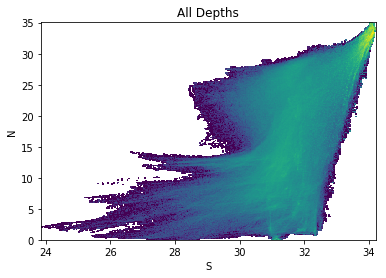

In [5]:
plt.hist2d(np.concatenate(Ss),np.concatenate(Ns),400,norm=LogNorm());
plt.xlabel('S')
plt.ylabel('N')
plt.title('All Depths')

In [6]:
Ss=list()
Ns=list()
for ii in range(0,366):
    idt=dt.datetime(2016,1,1)+dt.timedelta(days=ii)
    stencil='/results/forcing/LiveOcean/boundary_conditions/LiveOcean_v201905*{}.nc'
    flist=glob.glob(stencil.format(idt.strftime(ffmt)))
    for iff in flist:
        with nc.Dataset(iff) as f:
            Ss.append(f.variables['vosaline'][0,:20,0,:95].flatten())
            Ns.append(f.variables['NO3'][0,:20,0,:95].flatten())

Text(0.5, 1.0, 'Upper 20 Levels')

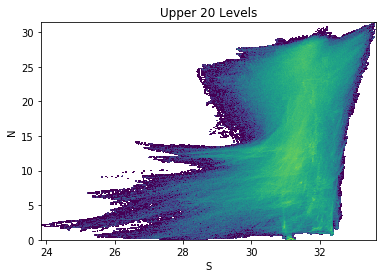

In [7]:
plt.hist2d(np.concatenate(Ss),np.concatenate(Ns),400,norm=LogNorm());
plt.xlabel('S')
plt.ylabel('N')
plt.title('Upper 20 Levels')

In [8]:
Ss=list()
Ns=list()
for ii in range(0,366):
    idt=dt.datetime(2016,1,1)+dt.timedelta(days=ii)
    stencil='/results/forcing/LiveOcean/boundary_conditions/LiveOcean_v201905*{}.nc'
    flist=glob.glob(stencil.format(idt.strftime(ffmt)))
    for iff in flist:
        with nc.Dataset(iff) as f:
            Ss.append(f.variables['vosaline'][0,20:,0,:95].flatten())
            Ns.append(f.variables['NO3'][0,20:,0,:95].flatten())

Text(0.5, 1.0, 'Lower 20 Levels')

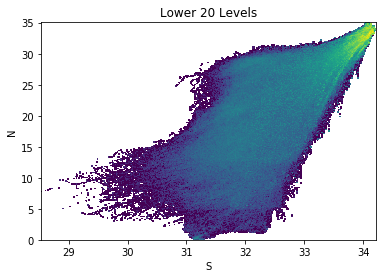

In [9]:
plt.hist2d(np.concatenate(Ss),np.concatenate(Ns),400,norm=LogNorm());
plt.xlabel('S')
plt.ylabel('N')
plt.title('Lower 20 Levels')

In [10]:
df = pd.read_csv('/ocean/eolson/MEOPAR/analysis-elise/notebooks/modelInput/OBC/bioOBCfit_NTS.csv',index_col=0)
mC=df.loc[0,'mC']
mT=df.loc[0,'mT']
mS=df.loc[0,'mS']

In [11]:
Ss=list()
Ns=list()
Ts=list()
for ii in range(0,366):
    idt=dt.datetime(2016,1,1)+dt.timedelta(days=ii)
    stencil='/results/forcing/LiveOcean/boundary_conditions/LiveOcean_v201905*{}.nc'
    flist=glob.glob(stencil.format(idt.strftime(ffmt)))
    for iff in flist:
        with nc.Dataset(iff) as f:
            Ss.append(f.variables['vosaline'][0,:20,0,:95].flatten())
            Ns.append(f.variables['NO3'][0,:20,0,:95].flatten())
            Ts.append(f.variables['votemper'][0,:20,0,:95].flatten())

Text(0.5, 1.0, 'Upper 20 Levels')

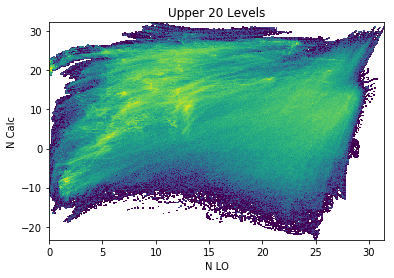

In [12]:
Ss=np.concatenate(Ss)
Ns=np.concatenate(Ns)
Ts=np.concatenate(Ts)
N2=mC+mT*Ts+mS*Ss
plt.hist2d(Ns,N2,400,norm=LogNorm());

plt.xlabel('N LO')
plt.ylabel('N Calc')
plt.title('Upper 20 Levels')

In [13]:
Ss=list()
Ns=list()
Ts=list()
for ii in range(0,366):
    idt=dt.datetime(2016,1,1)+dt.timedelta(days=ii)
    stencil='/results/forcing/LiveOcean/boundary_conditions/LiveOcean_v201905*{}.nc'
    flist=glob.glob(stencil.format(idt.strftime(ffmt)))
    for iff in flist:
        with nc.Dataset(iff) as f:
            Ss.append(f.variables['vosaline'][0,20:,0,:95].flatten())
            Ns.append(f.variables['NO3'][0,20:,0,:95].flatten())
            Ts.append(f.variables['votemper'][0,20:,0,:95].flatten())

Text(0.5, 1.0, 'Lower 20 Levels')

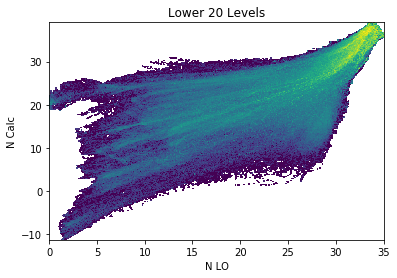

In [14]:
Ss=np.concatenate(Ss)
Ns=np.concatenate(Ns)
Ts=np.concatenate(Ts)
N2=mC+mT*Ts+mS*Ss
plt.hist2d(Ns,N2,400,norm=LogNorm());

plt.xlabel('N LO')
plt.ylabel('N Calc')
plt.title('Lower 20 Levels')

In [15]:
meanSi=np.zeros((366,40,95))
stdSi=np.zeros((366,40,95))
meanN=np.zeros((366,40,95))
stdN=np.zeros((366,40,95))
RMSEM=np.zeros((366,40,95))
RMSEP=np.zeros((366,40,95))
for ii in range(0,366):
    Sis=list()
    Ts=list()
    Ss=list()
    Ns=list()
    idt=dt.datetime(2016,1,1)+dt.timedelta(days=ii)
    stencil='/results/forcing/LiveOcean/boundary_conditions/LiveOcean_v201905*{}.nc'
    flist=glob.glob(stencil.format(idt.strftime(ffmt)))
    for iff in flist:
        with nc.Dataset(iff) as f:
            Sis.append(f.variables['Si'][:,:,0,:95])
            Ts.append(f.variables['votemper'][:,:,0,:95])
            Ss.append(f.variables['vosaline'][:,:,0,:95])
            Ns.append(f.variables['NO3'][:,:,0,:95])
    Sis=np.concatenate(Sis,0)
    Ns=np.concatenate(Ns,0)
    Ts=np.concatenate(Ts,0)
    Ss=np.concatenate(Ss,0)
    meanSi[ii,:,:]=np.mean(Sis,0)
    stdSi[ii,:,:]=np.std(Sis,0)
    meanN[ii,:,:]=np.mean(Ns,0)
    stdN[ii,:,:]=np.std(Ns,0)
    RMSEM[ii,:,:]=np.sqrt(np.mean((Ns-np.mean(Ns,0))**2,0))
    N2=mC+mT*Ts+mS*Ss
    RMSEP[ii,:,:]=np.sqrt(np.mean((Ns-N2)**2,0))
#np.savetxt('/home/eolson/pyCode/notebooks/modelInput/OBC/simat.csv',simat,delimiter=',')

/home/eolson/anaconda3/envs/py37/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


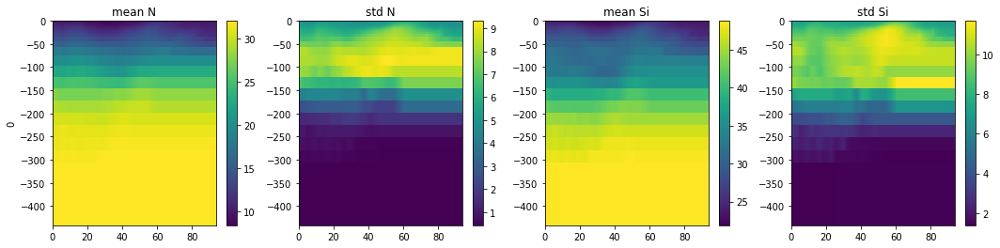

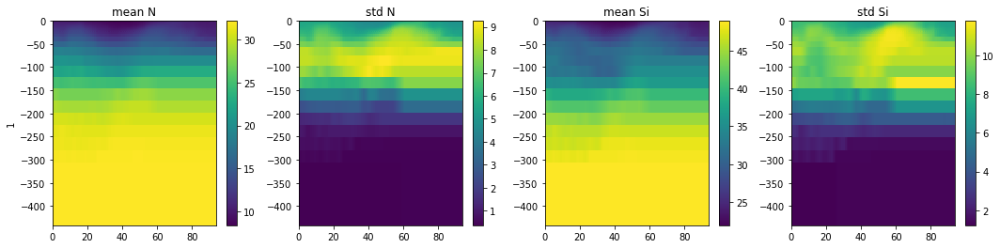

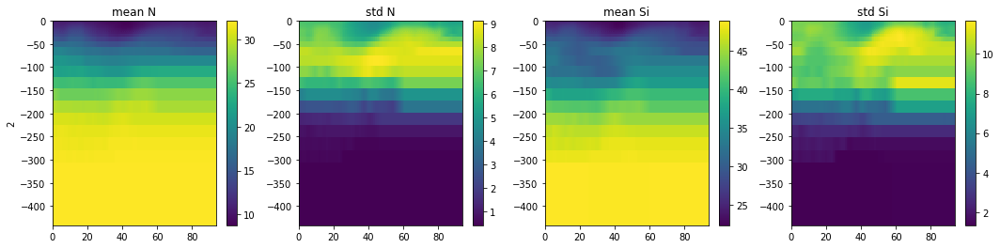

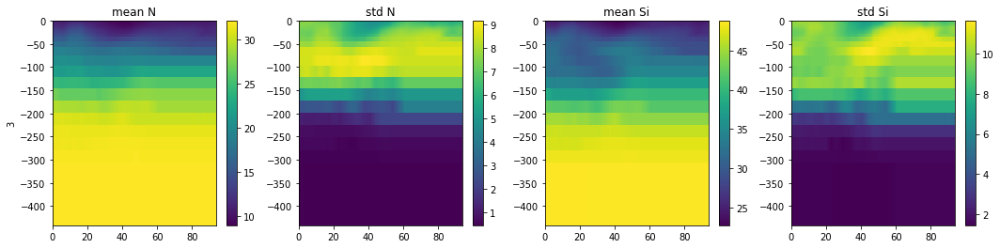

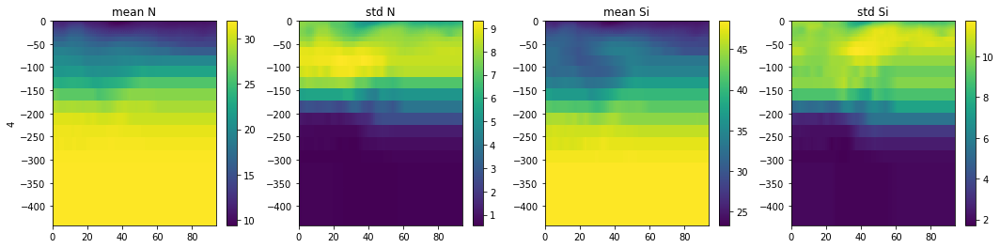

...

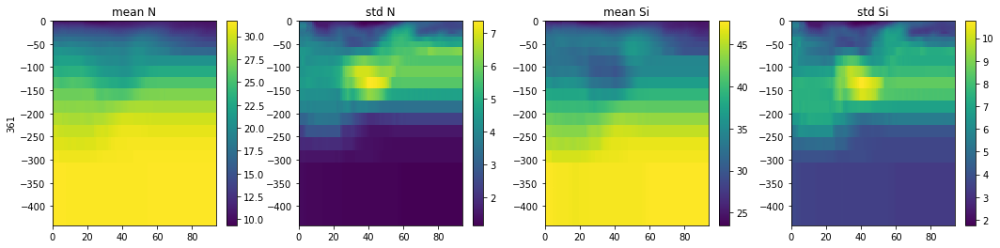

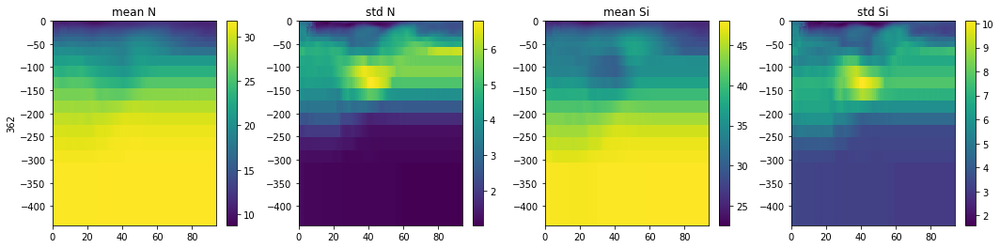

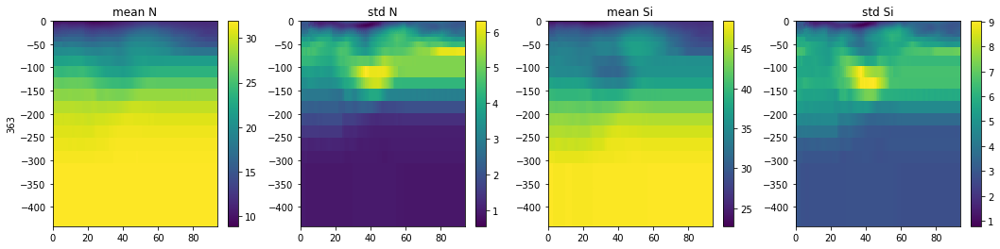

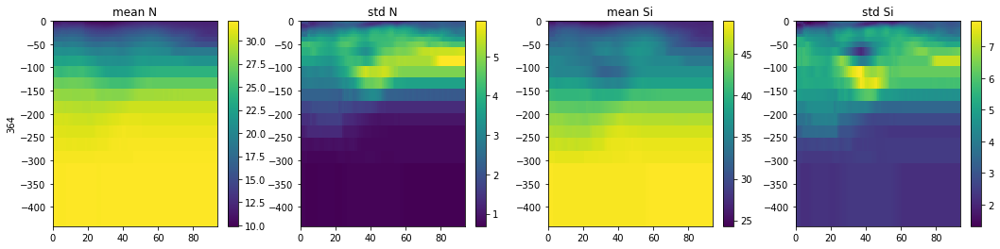

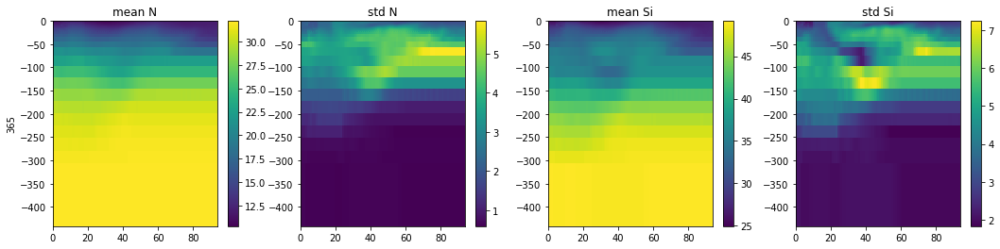

In [16]:
for ii in range(0,366):
    fig,ax=plt.subplots(1,4,figsize=(18,4))
    m0=ax[0].pcolormesh(np.arange(0,95),-1*z,meanN[ii,:,:])
    ax[0].set_title('mean N')
    fig.colorbar(m0,ax=ax[0])
    ax[0].set_ylabel(str(ii))
    m1=ax[1].pcolormesh(np.arange(0,95),-1*z,stdN[ii,:,:])
    fig.colorbar(m1,ax=ax[1])
    ax[1].set_title('std N')
    m2=ax[2].pcolormesh(np.arange(0,95),-1*z,meanSi[ii,:,:])
    fig.colorbar(m2,ax=ax[2])
    ax[2].set_title('mean Si')
    m3=ax[3].pcolormesh(np.arange(0,95),-1*z,stdSi[ii,:,:])
    fig.colorbar(m3,ax=ax[3])
    ax[3].set_title('std Si')

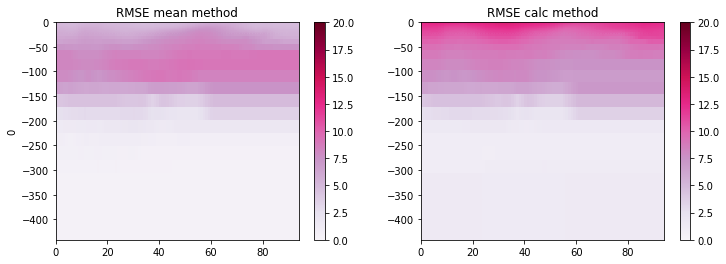

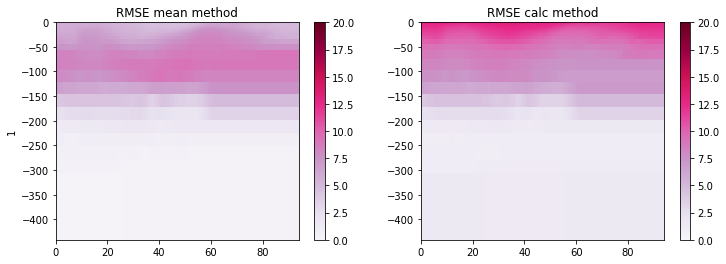

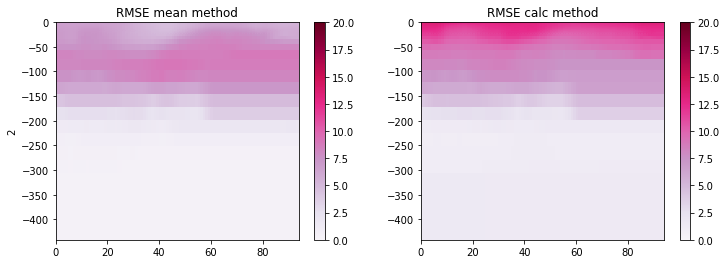

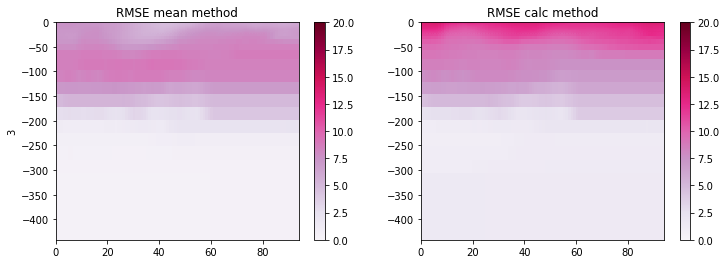

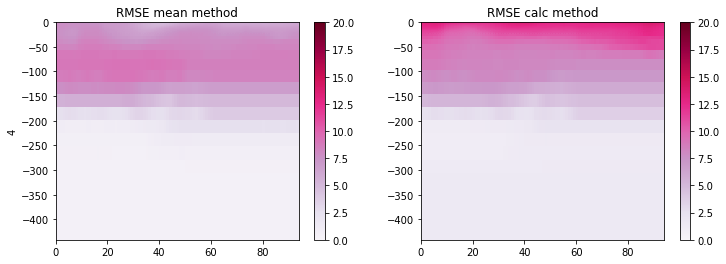

...

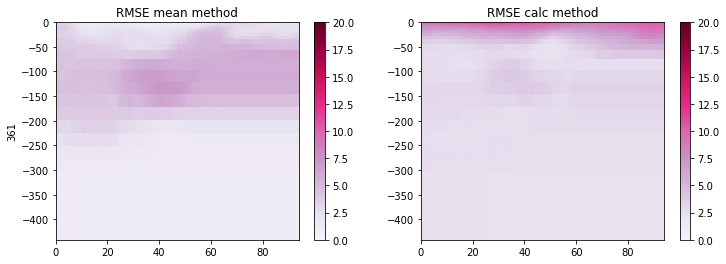

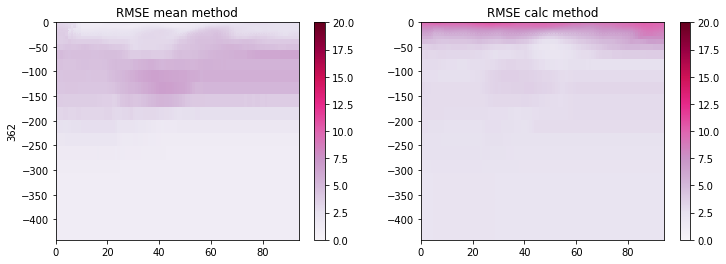

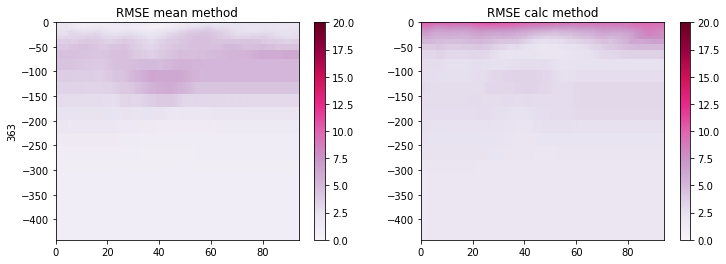

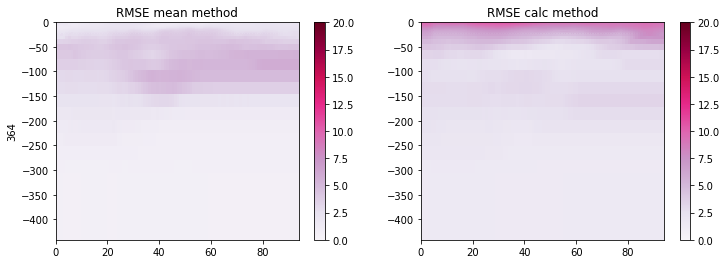

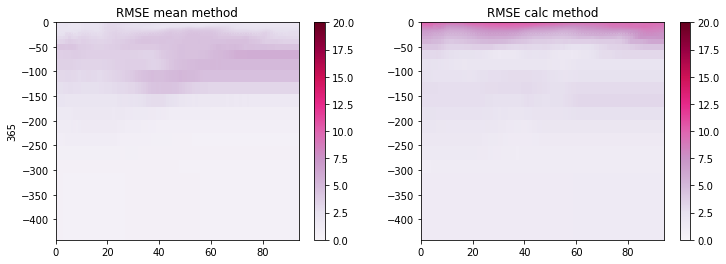

In [17]:
for ii in range(0,366):
    fig,ax=plt.subplots(1,2,figsize=(12,4))
    m0=ax[0].pcolormesh(np.arange(0,95),-1*z,RMSEM[ii,:,:],vmin=0,vmax=20,cmap=plt.get_cmap('PuRd'))
    ax[0].set_title('RMSE mean method')
    fig.colorbar(m0,ax=ax[0])
    ax[0].set_ylabel(str(ii))
    m1=ax[1].pcolormesh(np.arange(0,95),-1*z,RMSEP[ii,:,:],vmin=0,vmax=20,cmap=plt.get_cmap('PuRd'))
    fig.colorbar(m1,ax=ax[1])
    ax[1].set_title('RMSE calc method')